<a href="https://colab.research.google.com/github/jtorom/jtorom/blob/develop/Rocks_only_test_and_predict.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Configuraciones

In [1]:
!pip install --upgrade -q gspread


In [2]:
from google.colab import drive
drive.mount('/content/drive')
import gspread
from google.colab import auth
auth.authenticate_user()
from oauth2client.client import GoogleCredentials
from google.auth import default
creds, _ = default()

gc = gspread.authorize(creds)

def save_to_gsheets(df, sheet_name, worksheet_name='Sheet1'):
    sheet = gc.open(sheet_name)
    worksheet = sheet.worksheet(worksheet_name)
    # convertimos el tipo de las columnas que sean datetime a string
    for column in df.columns[df.dtypes == 'datetime64[ns]']:
        df[column] = df[column].astype(str)
    # reemplazamos valores NaN por strings vacíos
    #worksheet.update([df.columns.values.tolist()] + df.fillna('').values.tolist())
    worksheet.append_rows(df.fillna('').values.tolist())
    print(f'DataFrame escrito en la hoja {sheet_name} / {worksheet_name}.')



import numpy as np
import pandas as pd
import datetime
import pytz
tz = pytz.timezone('America/Santiago')
ct = datetime.datetime.now(tz=tz)



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import os
path = '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Train/'
jpg_count = len([f for f in os.listdir(path) if f.endswith('.jpg')])
print(jpg_count)

213


In [4]:
folder="rock_data20231226T1803/"
if not os.path.exists("/content/logs/"+folder):
  os.makedirs("/content/logs")
  os.chdir("/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/logs")
  os.system("cp -rf "+ folder +" /content/logs/"+folder)


In [5]:
os.chdir('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis')
%cd Mask-RCNN
#!pip list
!pip3 install -r requirements.txt
!python3 setup.py install

/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/Mask-RCNN
ERROR: Could not find a version that satisfies the requirement numpy==2.19.2 (from versions: 1.3.0, 1.4.1, 1.5.0, 1.5.1, 1.6.0, 1.6.1, 1.6.2, 1.7.0, 1.7.1, 1.7.2, 1.8.0, 1.8.1, 1.8.2, 1.9.0, 1.9.1, 1.9.2, 1.9.3, 1.10.0.post2, 1.10.1, 1.10.2, 1.10.4, 1.11.0, 1.11.1, 1.11.2, 1.11.3, 1.12.0, 1.12.1, 1.13.0, 1.13.1, 1.13.3, 1.14.0, 1.14.1, 1.14.2, 1.14.3, 1.14.4, 1.14.5, 1.14.6, 1.15.0, 1.15.1, 1.15.2, 1.15.3, 1.15.4, 1.16.0, 1.16.1, 1.16.2, 1.16.3, 1.16.4, 1.16.5, 1.16.6, 1.17.0, 1.17.1, 1.17.2, 1.17.3, 1.17.4, 1.17.5, 1.18.0, 1.18.1, 1.18.2, 1.18.3, 1.18.4, 1.18.5, 1.19.0, 1.19.1, 1.19.2, 1.19.3, 1.19.4, 1.19.5, 1.20.0, 1.20.1, 1.20.2, 1.20.3, 1.21.0, 1.21.1, 1.21.2, 1.21.3, 1.21.4, 1.21.5, 1.21.6, 1.22.0, 1.22.1, 1.22.2, 1.22.3, 1.22.4, 1.23.0rc1, 1.23.0rc2, 1.23.0rc3, 1.23.0, 1.23.1, 1.23.2, 1.23.3, 1.23.4, 1.23.5, 1.24.0rc1, 1.24.0rc2, 1.24.0, 1.24.1, 1.24.2, 1.24.3, 1.24.4, 1.25.0rc1, 1.25.0, 1.25.1, 1.25.2, 1.26.0b1, 1.

In [6]:
#import tensorflow as tf
#gpus = tf.config.experimental.list_physical_devices('GPU')
#if gpus:
#  try:
#    for gpu in gpus:
#      tf.config.experimental.set_memory_growth(gpu, True)
#  except RuntimeError as e:
#    print(e)


#from tensorflow.python.client import device_lib
#with tf.device('/device:GPU:0'):
#  print('Hola GPU')


DEVICE = "/gpu:0"

In [7]:

import numpy as np
import pandas as pd
import time
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import os
import cv2
import os
import sys
import random
import math
import re
import time
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
import json
import imgaug
import tensorflow as tf
import numpy as np
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Dense, Activation,Dropout,Conv2D, MaxPooling2D,BatchNormalization
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras import regularizers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Model, load_model, Sequential
from sklearn.metrics import confusion_matrix, classification_report
from tensorflow.keras.layers import Dense,Flatten , Conv2D , MaxPooling2D , Dropout
from tensorflow.keras.models import Model , Sequential
from tensorflow.keras.layers.experimental.preprocessing import Rescaling
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
import datetime

In [8]:
ROOT_DIR = os.path.abspath('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis')

sys.path.append(ROOT_DIR)

In [9]:
os.chdir('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/Mask-RCNN/')
from mrcnn.config import Config
from mrcnn import utils
os.chdir('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/Mask-RCNN/mrcnn/')
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log
%matplotlib inline

In [10]:
MODEL_DIR = os.path.abspath('/content/logs')
#MODEL_DIR = os.path.abspath('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/logs')

if not os.path.exists(MODEL_DIR):
  os.mkdir(MODEL_DIR)

COCO_MODEL_PATH = os.path.abspath('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/logs/mask_rcnn_coco.h5')


In [11]:

if os.path.exists(os.path.join(COCO_MODEL_PATH)):
  print("coco model exist")
%cd /content/drive/MyDrive/Colab Notebooks/WorkspaceTesis
#!ls

coco model exist
/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis


In [12]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
DATA_DIR = os.path.abspath('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/')

In [13]:

os.chdir('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/')
DATASET_TRAIN_DIR=os.path.join(DATA_DIR,'Train')
DATASET_VAL_DIR=os.path.join(DATA_DIR,'Validation')
DATASET_TEST_DIR=os.path.join(DATA_DIR,'Test')


config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)



In [14]:
path='/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Train'
imageSize = [350, 536,3]
sizeEpochSteps = jpg_count ##mismo valor que la cantidad de img en train

def ajustarTamano(path):
  os.chdir(path)
  for i,f in enumerate(os.listdir('.')):

    file_name, file_extension = os.path.splitext(f)
    #print(file_extension)
    if os.path.isfile(f) and file_extension=='.jpg':
      try:

        image_path_jpg = f
        print(image_path_jpg)
        img = tf.io.read_file(image_path_jpg)
        #print(img.get_shape().as_list()) # []
        img = tf.image.decode_jpeg(img)
        #print(img.get_shape().as_list())
        img_resized = tf.image.resize(img, [imageSize[0], imageSize[1]])
        img_resized = img_resized.eval(session=session)
        #print(type(img_resized))
        img_resized_tensor = tf.reshape(img_resized, [imageSize[0], imageSize[1]] )
        img_resized = img_resized_tensor.eval(session=session)
        cv2.imwrite(f, img_resized)
      except:
        print("Error en :" , f)


#path='/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Train'
#ajustarTamano(path)
#path='/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Test'
#ajustarTamano(path)
#path='/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation'
#ajustarTamano(path)

In [15]:
#from mrcnn.config import Config
#os.chdir('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/Mask-RCNN/')
#from config_rocks import Rocks

class Rocks(Config):

  NAME ="rock_Data"
  IMAGES_PER_GPU = 1
  GPU_COUNT = 1
  NUM_CLASSES = 2 #Background + rock"
  STEPS_PER_EPOCH = sizeEpochSteps # Se pone el mismo n mero de imagenes que hay en la carpeta Train
  DETECTION_MIN_CONFIDENCE = 0.50
  # MiniMask
  USE_MINI_MASK = False
  IMAGE_SHAPE = imageSize
  LEARNING_RATE=0.00556
  DETECTION_MAX_INSTANCES=300
  VALIDATION_STEPS = 100

In [16]:
config = Rocks()
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        300
DETECTION_MIN_CONFIDENCE       0.5
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.00556
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE        

In [17]:
from PIL import Image,ImageDraw
axis_Width = 15

In [18]:

class RocksDataset(utils.Dataset):

  def load_dataset(self, dataset_dir):

    self.add_class('dataset', 1, 'rock')

    for i, filename in enumerate(os.listdir(dataset_dir)):
      annotation_file = os.path.join(dataset_dir , filename.replace('.jpg', '.json'))
      if '.jpg' in filename and os.path.isfile(annotation_file):
        self.add_image('dataset',image_id=i,path=os.path.join(dataset_dir , filename),annotation=annotation_file)



  def extract_masks(self, filename):
    json_file = os.path.join(filename) #Devuelve el nombre del fichero con string->’.
    with open(json_file) as f:
      img_anns = json.load(f)
    n_masks = 0
    for anno in img_anns['shapes']:
      if anno['label']=='rock':
        n_masks+=1#
    masks = np.zeros([img_anns['imageHeight'], img_anns['imageWidth'], n_masks], dtype='uint8')
    classes = []#
    i=0
    for anno in img_anns['shapes']:
      if anno['label']=='rock':
        mask = np.zeros([img_anns['imageHeight'], img_anns['imageWidth']], dtype=np.uint8)
        cv2.fillPoly(mask, np.array([anno['points']], dtype=np.int32), 1)
        masks[:, :, i] = mask
        classes.append(self.class_names.index(anno['label']))
        i+=1
    return masks , classes


  def load_mask(self, image_id):
    info = self.image_info[image_id]
    path = info['annotation']
    masks, classes = self.extract_masks(path)
    #print("masks:", masks)
    return masks, np.asarray(classes, dtype='int32')

  def image_reference(self, image_id):
    info = self.image_info[image_id]
    return info['path']




In [19]:
dataset_train = RocksDataset()
dataset_train.load_dataset(DATASET_TRAIN_DIR)
dataset_train.prepare()


In [20]:

lendataset_train=len(dataset_train.image_ids)
print("Image Count: {}".format(len(dataset_train.image_ids)))
print("Class Count: {}".format(dataset_train.num_classes))
for i, info in enumerate(dataset_train.class_info):
  print("{:3}. {:50}".format(i, info['name']))


Image Count: 213
Class Count: 2
  0. BG                                                
  1. rock                                              


In [21]:

dataset_val = RocksDataset()
dataset_val.load_dataset(DATASET_VAL_DIR)
dataset_val.prepare()

In [22]:

lendataset_val=len(dataset_val.image_ids)
print("Image Count: {}".format(len(dataset_val.image_ids)))
print("Class Count: {}".format(dataset_val.num_classes))
for i, info in enumerate(dataset_val.class_info):
  print("{:3}. {:50}".format(i, info['name']))

Image Count: 56
Class Count: 2
  0. BG                                                
  1. rock                                              


In [23]:

dataset_test = RocksDataset()
dataset_test.load_dataset(DATASET_TEST_DIR)
dataset_test.prepare()
print('Test: %d images' % len(dataset_test.image_ids))

Test: 53 images


In [24]:

lendataset_test=len(dataset_test.image_ids)
print("Image Count: {}".format(len(dataset_test.image_ids)))
print("Class Count: {}".format(dataset_test.num_classes))
for i, info in enumerate(dataset_test.class_info):
  print("{:3}. {:50}".format(i, info['name']))


Image Count: 53
Class Count: 2
  0. BG                                                
  1. rock                                              


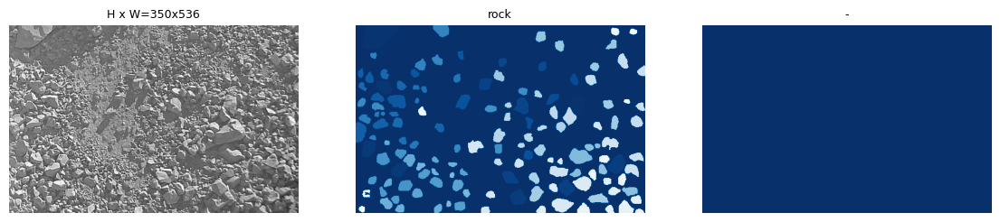

In [25]:

image_ids=np.random.choice(dataset_train.image_ids,1)
for image_id in image_ids:
  image = dataset_train.load_image(image_id)
  mask, class_ids = dataset_train.load_mask(image_id)
  visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names,2)



In [26]:
epochsHead=0
epochsLast=0
dataResult= {
    "Fecha": ct.isoformat(),
    "FechaInicio": ct.isoformat(),
    "FechaFin": "",
    "CountTrain" : [lendataset_train],
    "CountTest" : [lendataset_test],
    "CountVal" : [lendataset_val],
    "EphocsHead" : [epochsHead],
    "EphocsLast" : [epochsLast],
    "folderName" : "",
    "folderPesosAnteriores":folder,
    "Confidence" : [Rocks.DETECTION_MIN_CONFIDENCE],
    "LearningRate": [Rocks.LEARNING_RATE],
    "Precision" : [0],
    "Recall" : [0],
    "F1" : [0],
    "Accuracy" : [0],
    "init_with": [0],
    "epochNum": 0,
    "type": "Inference"
}

df = pd.DataFrame(dataResult)
save_to_gsheets(df, 'ResultadosColab', worksheet_name='Sheet1')

DataFrame escrito en la hoja ResultadosColab / Sheet1.


# Revisión del modelo

In [27]:
class InferenceConfig(Rocks):
  GPU_COUNT = 1
  IMAGES_PER_GPU = 1


In [28]:
inference_config = InferenceConfig()
model = modellib.MaskRCNN(mode="inference", config=inference_config ,model_dir=MODEL_DIR)


Instructions for updating:
Use fn_output_signature instead


In [29]:
# Show stats of all trainable weights
#visualize.display_weight_stats(model)

In [30]:
model_path = model.find_last()
print("Loading weights from ", model_path)
model.load_weights(model_path , by_name=True)



self.model_dir: /content/logs
Dir_names: ['rock_data20231226T1803']
Loading weights from  /content/logs/rock_data20231226T1803/mask_rcnn_rock_data_0020.h5
Re-starting from epoch 20


In [31]:
dataset_val.image_ids

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55])

In [32]:
for i in dataset_val.image_ids:
  print("i:", i)
  info=dataset_val.image_info[i]
  print(info)

i: 0
{'id': 1, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_092352.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_092352.json'}
i: 1
{'id': 3, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_084252.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_084252.json'}
i: 2
{'id': 4, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_092431.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_092431.json'}
i: 3
{'id': 6, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_092513.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_202

In [33]:
image_id=45
original_image , image_meta , gt_class_id ,gt_bbox , gt_mask = modellib.load_image_gt(dataset_val , inference_config , image_id )
#original_image , image_meta , gt_class_id ,gt_bbox , gt_mask = modellib.load_image_gt(dataset_val , inference_config , image_id, use_mini_mask=False)


log("original_image", original_image)
log("image_meta", image_meta)
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

original_image           shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
image_meta               shape: (14,)                 min:    0.00000  max: 1024.00000  float64
gt_class_id              shape: (5,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (5, 4)                min:  103.00000  max:  795.00000  int32
gt_mask                  shape: (1024, 1024, 5)       min:    0.00000  max:    1.00000  uint8


(5,)
{'id': 74, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220413_113802.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220413_113802.json'}


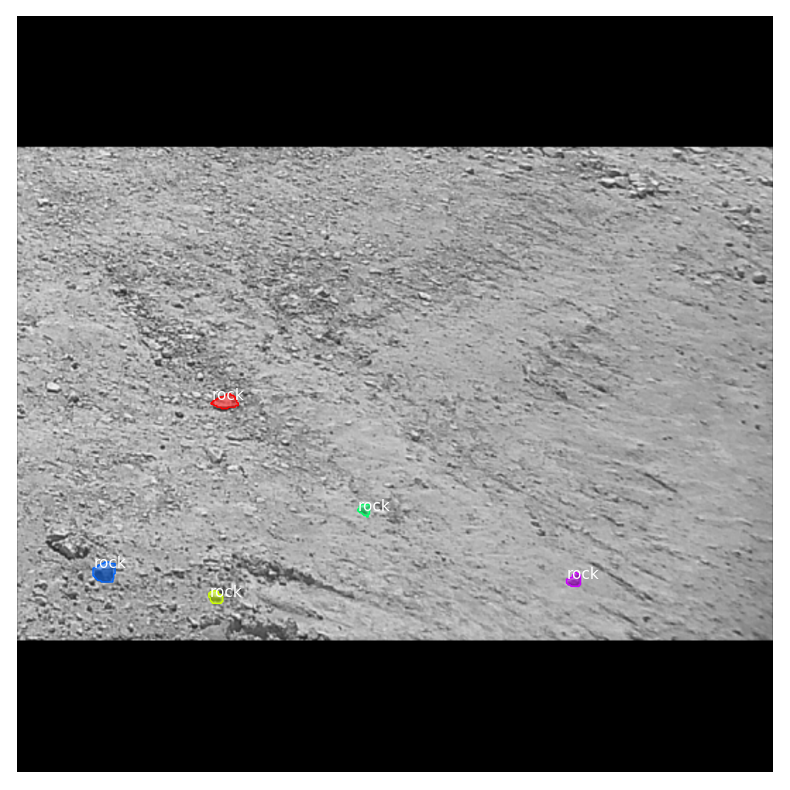

In [34]:
def get_ax(rows=1, cols=1, size=10):
  _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
  return ax
#visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, dataset_val.class_names, figsize=(8, 8))
visualize.display_instances(original_image , gt_bbox,gt_mask, gt_class_id, dataset_val.class_names,
                  scores=None, title="",
                  ax=get_ax(),show_mask=True,
                  show_bbox=False,captions=False)
print(gt_class_id.shape)
info=dataset_val.image_info[image_id]
print(info)

In [35]:
results = model.detect([original_image], verbose=1)

Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


(5,)


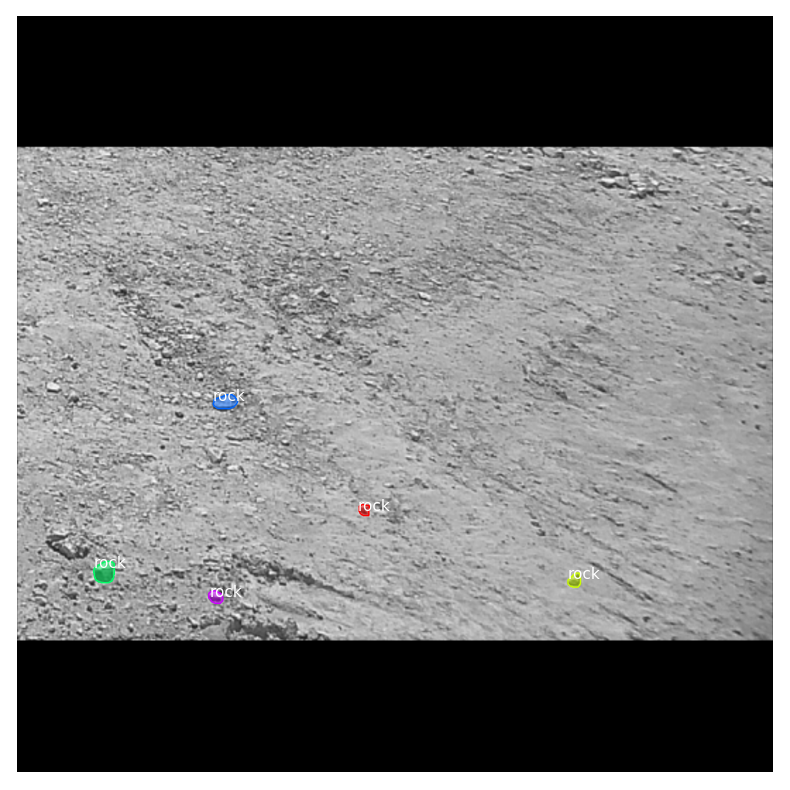

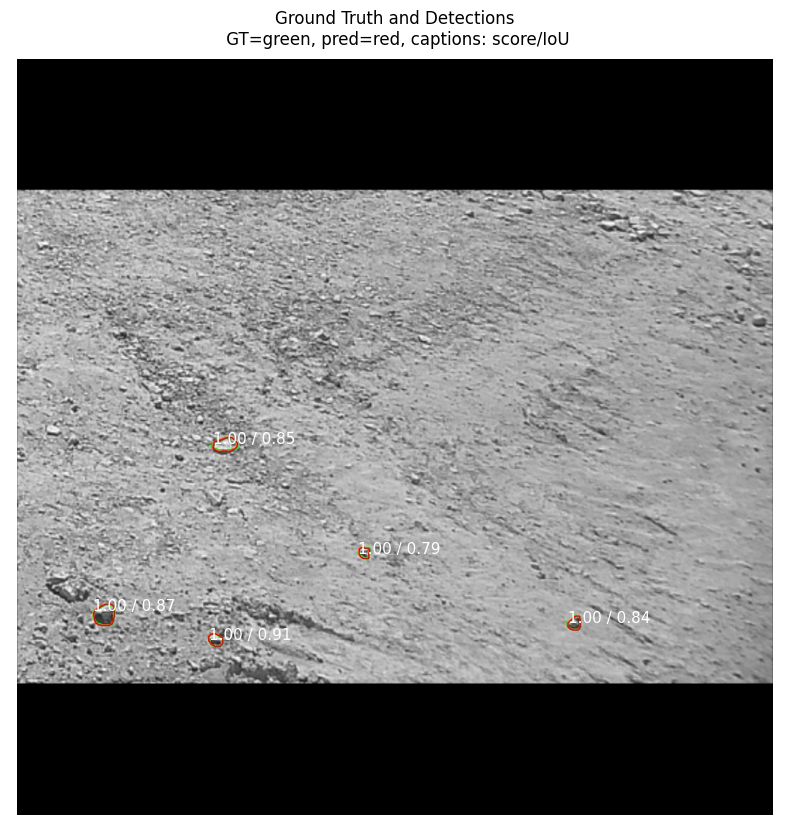

In [36]:
r = results[0]
#visualize.display_instances(original_image , r['rois'], r['masks'], r['class_ids'], dataset_val.class_names, r['scores'], ax=get_ax())
#print(r['class_ids'].shape)
#def display_instances(image, boxes, masks, class_ids, class_names,
#                      scores=None, title="",
#                      figsize=(16, 16), ax=None,
#                      show_mask=True, show_bbox=True,
#                      colors=None, captions=None):

visualize.display_instances(original_image , r['rois'], r['masks'], r['class_ids'],  dataset_val.class_names,
                  scores=None, title="",
                  ax=get_ax(),show_mask=True,
                  show_bbox=False,captions=False)

print(r['class_ids'].shape)


visualize.display_differences(
    original_image,
    gt_bbox, gt_class_id, gt_mask,
    r['rois'], r['class_ids'], r['scores'], r['masks'],
    dataset_val.class_names, ax=get_ax(),
    show_box=False, show_mask=False,
    iou_threshold=0.5, score_threshold=0.5)

In [37]:
#if not os.path.exists('/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/Mask-RCNN/Confusion-matrix-for-Mask-R-CNN'):
#  !git clone https://github.com/Altimis/Confusion-matrix-for-Mask-R-CNN.git


from mrcnn import utils
import pandas as pd
import numpy as np
import os
gt_tot = np.array([])
pred_tot = np.array([])
#mAP list
mAP_ = []

In [38]:
"""
dataset_train

Image Count: 213
Class Count: 2
  0. BG
  1. rock

dataset_val
Image Count: 56
Class Count: 2
  0. BG
  1. rock


dataset_test
Image Count: 53
Class Count: 2
  0. BG
  1. rock
"""
def cantEtiquetas(data):
  cant=0
  for image_id in data.image_ids:
    try:
      image, image_meta, gt_class_id, gt_bbox, gt_mask =modellib.load_image_gt(data, config, image_id)
      modellib.load_image_gt(data, config, image_id)
      info=data.image_info[image_id]
      print(info)
      print("Cant real:",len(gt_class_id))
      cant+=len(gt_class_id)
    except:
      cant+=0
      #print("error")
  return cant

#print(cantEtiquetas(dataset_train))
#print(cantEtiquetas(dataset_val))
#print(cantEtiquetas(dataset_test))




In [39]:
rr = dataset_val.image_ids[image_id]
info2=dataset_val.image_info[image_id]
print(info2)
print(rr)

{'id': 74, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220413_113802.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220413_113802.json'}
45


{'id': 1, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_092352.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_092352.json'}
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
(23,)
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
<class 'numpy.ndarray'>
the actual len of the gt vect is :  34
the actual len of the pred vect is :  45
{'id': 3, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220414_084252.jpg', 'anno

/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/Mask-RCNN/mrcnn/visualize.py:332: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  _, ax = plt.subplots(1)


the actual len of the gt vect is :  2036
the actual len of the pred vect is :  2411
{'id': 22, 'source': 'dataset', 'path': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220419_153504.jpg', 'annotation': '/content/drive/MyDrive/Colab Notebooks/WorkspaceTesis/data/Validation/SH04_20220419_153504.json'}
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  177.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   73.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
(67,)
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1]
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1

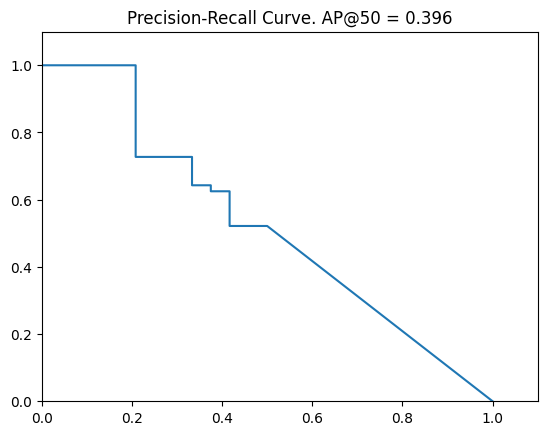

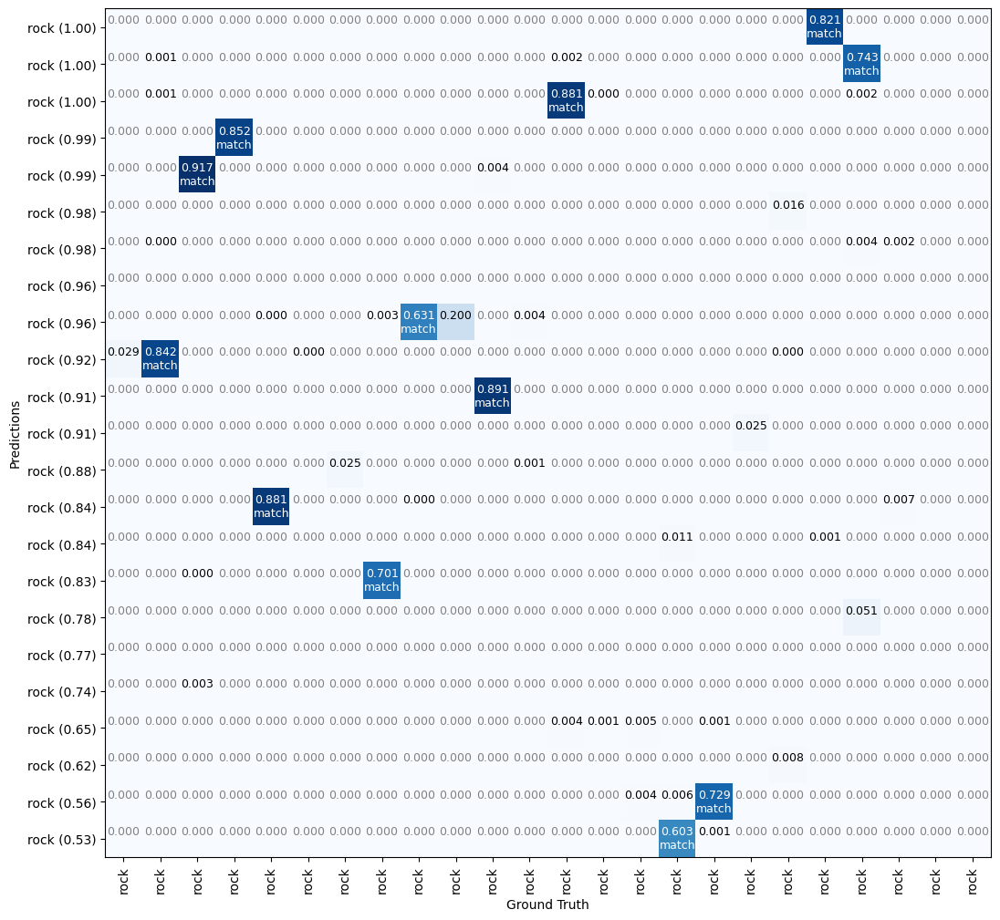

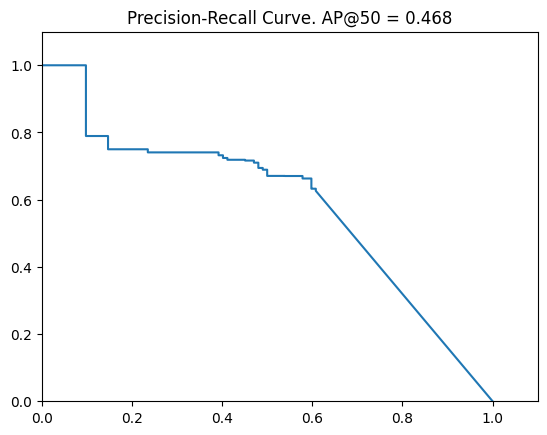

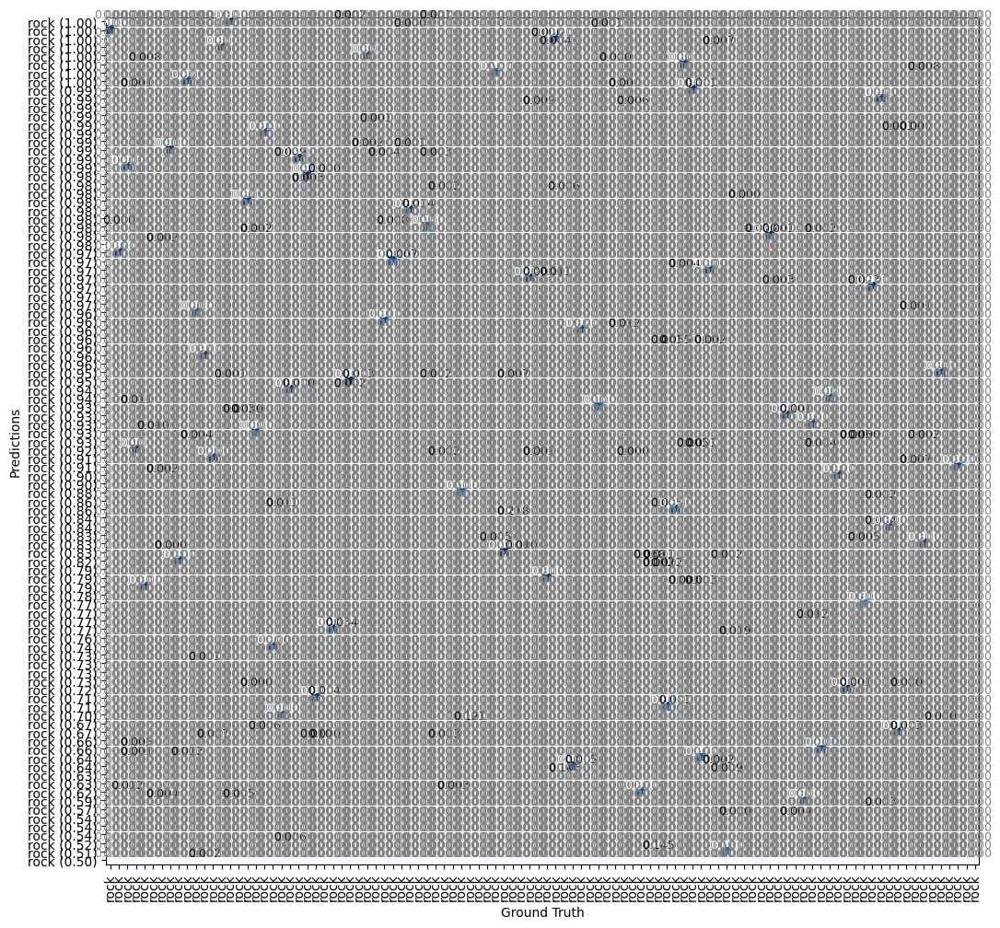

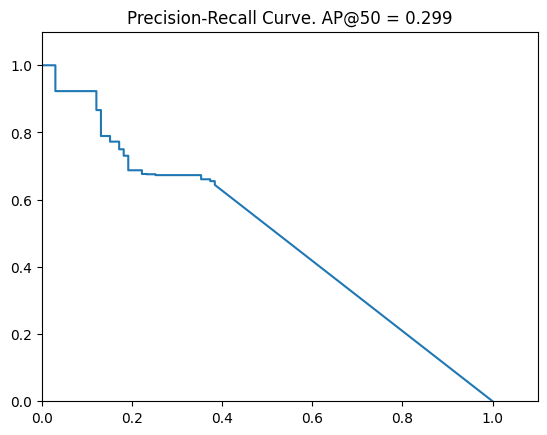

...

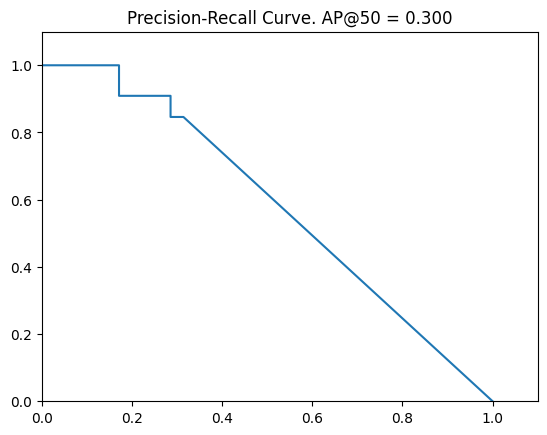

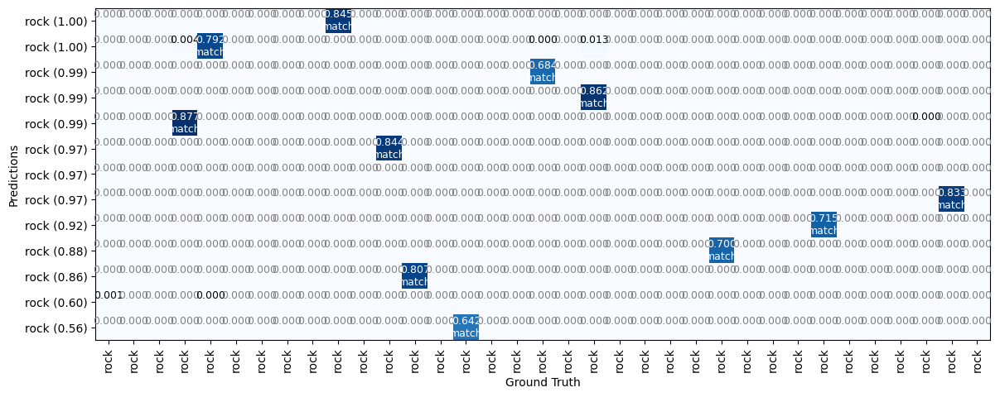

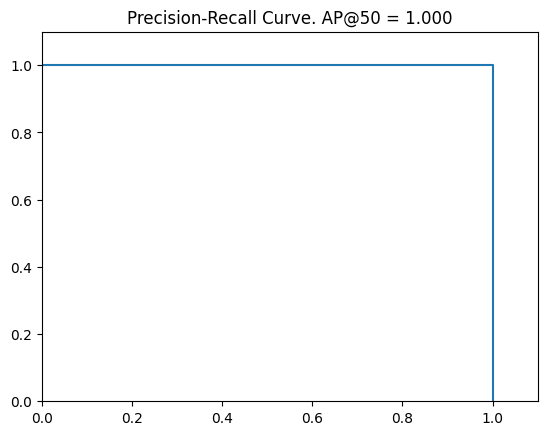

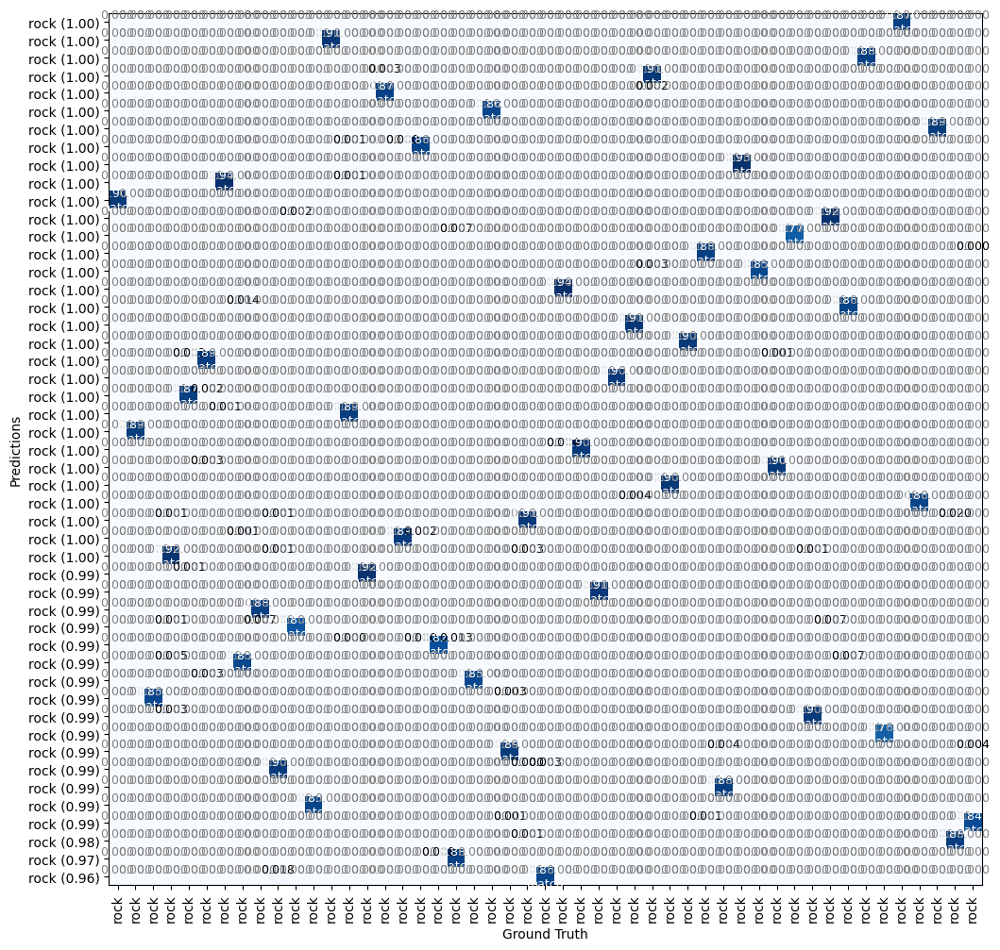

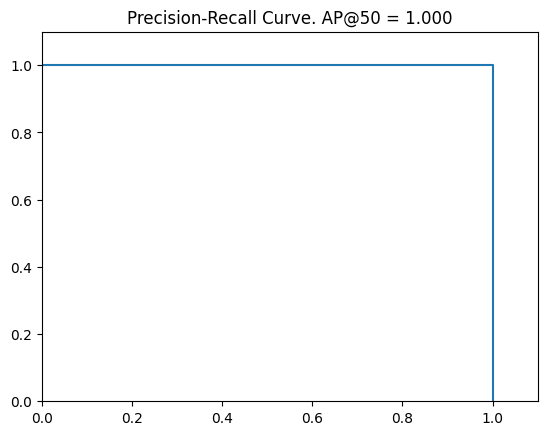

In [ ]:
config=inference_config
#for image_id in dataset_test.image_ids:
for image_id in dataset_val.image_ids:
  #info=dataset_test.image_info[image_id]
  info=dataset_val.image_info[image_id]
  #gt_tot={}
  #pred_tot={}

  #if info['id']==info2['id']:
  print(info)
  #image, image_meta, gt_class_id, gt_bbox, gt_mask =modellib.load_image_gt(dataset_test, config, image_id)
  image, image_meta, gt_class_id, gt_bbox, gt_mask =modellib.load_image_gt(dataset_val, config, image_id)
  #modellib.load_image_gt(dataset_test, config, image_id)
  #modellib.load_image_gt(dataset_val, config, image_id)
  #print(gt_bbox)
  #print(gt_mask)
  #print(gt_class_id)
  #print(gt_bbox)
  results = model.detect([image], verbose=1)
  r = results[0]
  print(r['class_ids'].shape)

  gt, pred = utils.gt_pred_lists(gt_class_id,gt_bbox, r['class_ids'],  r['rois'])

  print(gt_class_id)
  print(r['class_ids'])
  print(type(gt_tot))

  #print("Cant modelo:",len(pred))
  #print("Cant real:",len(gt_class_id))

  #if(len(pred)>len(gt_class_id)):
  #    pred=pred[0:len(gt_class_id)]

  gt_tot = np.append(gt_tot, gt_class_id)
  pred_tot=np.append(pred_tot, pred)

  AP_, precision_, recall_, overlap_ = utils.compute_ap(gt_bbox, gt_class_id, gt_mask,r['rois'], r['class_ids'], r['scores'], r['masks'])
  visualize.plot_precision_recall(AP_, precision_, recall_)
  visualize.plot_overlaps(gt_class_id, r['class_ids'], r['scores'], overlap_, dataset_test.class_names)

  print("the actual len of the gt vect is : ", len(gt_tot))
  print("the actual len of the pred vect is : ", len(pred_tot))

  mAP_.append(AP_)

In [44]:
gt_tot=gt_tot.astype(int)
pred_tot=pred_tot.astype(int)
save_dir = "/content/output"
gt_pred_tot_json = {"gt_tot" : gt_tot, "pred_tot" : pred_tot}
df = pd.DataFrame(gt_pred_tot_json)
if not os.path.exists(save_dir):
  os.makedirs(save_dir)
df.to_json(os.path.join(save_dir ,"gt_pred_test.json"))


In [45]:
#print("ground truth list : ",gt_tot)
#print("predicted list : ",pred_tot)
tp,fp,fn=utils.plot_confusion_matrix_from_data(gt_tot,pred_tot,columns=['BG','rock'],cmap="Blues", fz=10, figsize=(10,10), lw=0.5)
#print(tp)
#print(fp)
#print(fn)
accurracyMCONF=(tp[1]/(tp[1]+fp[0]))

ValueError: Shape of passed values is (1, 1), indices imply (2, 2)

In [ ]:
#Función para evaluar el modelo con las imágenes de validacion 10%
from mrcnn.model import load_image_gt
from mrcnn.model import mold_image
from mrcnn.utils import compute_ap, compute_recall
from mrcnn import utils

from numpy import zeros
from numpy import asarray
from numpy import expand_dims
from numpy import mean

def evaluate_model(dataset, model, cfg):
    APs = list();
    ARs = list();
    F1_scores = list();
    for image_id in dataset.image_ids:
        image, image_meta, gt_class_id, gt_bbox, gt_mask = load_image_gt(dataset, cfg, image_id)
        scaled_image = mold_image(image, cfg)
        sample = expand_dims(scaled_image, 0)
        yhat = model.detect(sample, verbose=0)
        r = yhat[0]
        AP, precisions, recalls, overlaps = utils.compute_ap(gt_bbox, gt_class_id, gt_mask, r["rois"], r["class_ids"], r["scores"], r['masks'])
        AR, positive_ids = compute_recall(r["rois"], gt_bbox, iou=0.5)
        ARs.append(AR)
        F1_scores.append((2* (mean(precisions) * mean(recalls)))/(mean(precisions) + mean(recalls)))
        APs.append(AP)
        #visualize.plot_precision_recall(AP, precisions, recalls)

    mAP = mean(APs)
    mAR = mean(ARs)
    return mAP, mAR, F1_scores

#mAP, mAR, F1_score = evaluate_model(dataset_val, model, inference_config)
#print("Precisión Media mAP (mean average precision): %.4f" % mAP)
#print("Recall Promedio mAR: (mean average recall): %.4f" % mAR)

#F1_score_2 = (2 * mAP * mAR)/(mAP + mAR)
#print('F1-score : ', F1_score_2)

In [ ]:
mAP, mAR, F1_score = evaluate_model(dataset_test, model, inference_config)
print("Precisión Media mAP (mean average precision): %.4f" % mAP)
print("Recall Promedio mAR: (mean average recall): %.4f" % mAR)
F1_score_2 = (2 * mAP * mAR)/(mAP + mAR)
print('F1-score : ', F1_score_2)


In [ ]:
tz = pytz.timezone('America/Santiago')
ct = datetime.datetime.now(tz=tz)

dataResult.update({"epochNum": model.epoch})
dataResult.update({"Precision": mAP})
dataResult.update({"Recall": mAR})
dataResult.update({"F1": F1_score_2})
dataResult.update({"Accuracy": accurracyMCONF})
dataResult.update({"FechaFin": ct.isoformat()})



print(dataResult)
df = pd.DataFrame(dataResult)
save_to_gsheets(df, 'ResultadosColab', worksheet_name='Sheet1')

In [ ]:
#Se extraen los datos de p r d i d a s y se muestran con el tensorflow
#os.chdir('/content/logs/')
#import tensorflow.compat.v1 as tf
#%load_ext tensorboard
#sess = tf.Session()
#file_writer = tf.summary.FileWriter( "/content/logs/"+folder , sess.graph )
#%tensorboard --logdir "/content/logs/"+folder
#%reload_ext tensorboard

In [ ]:
#from keras.utils import plot_model
#plot_model(model.keras_model, 'net.png', show_shapes=True)